# Loading data

In [1]:
import pandas as pd
import functools
import plotly.express as px
import json
import os

import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt


from sklearn.cluster import DBSCAN
from sklearn import metrics
from sklearn.datasets import make_blobs
from sklearn.preprocessing import StandardScaler

In [2]:
compression = ".xz"
dataFolderName = "data"
dataFolderPath = os.path.join(".",dataFolderName)

if not(os.path.exists(dataFolderPath)):
    print("ERROR: data folder not found")

    
def file_path(file_name: str) -> str:
    return os.path.join(dataFolderPath, file_name)

list_of_cities_path = file_path("CityList.json")

with open(list_of_cities_path, "r") as filehandle:
    cities = json.load(filehandle)

density = dict()
demographics = dict()
tiles = dict()
demographicsDaily = dict()
for city in cities:
    #Path to data
    tiles_path = file_path(f'{city}Tiles.pkl{compression}')
    hourly_dem_path = file_path(f'{city}HourlyDemographics.pkl{compression}')
    hourly_density_path = file_path(f'{city}HourlyDensity.pkl{compression}')
    daily_density_path = file_path(f'{city}DensityDaily.pkl{compression}')
    daily_demographics_path = file_path(f'{city}DemographicsDaily.pkl{compression}')
    
    density[city] = pd.read_pickle(hourly_density_path)
    demographics[city] = pd.read_pickle(hourly_dem_path)
    demographicsDaily[city] = pd.read_pickle(daily_demographics_path)
    tiles[city] = pd.read_pickle(tiles_path)
    tiles[city]['lat'] = (tiles[city]['ll_lat'] + tiles[city]['ur_lat'])/2
    tiles[city]['lon'] = (tiles[city]['ll_lon'] + tiles[city]['ur_lon'])/2

In [3]:
for c in cities:
    city =  c
    df = tiles[city].set_index("tileID").join(demographics[city]).reset_index().set_index("tileID")[["time", "lat", "lon", "male_proportion"]]
    df1 = df.reset_index().set_index(["tileID",'time']).join(density[city])
    df1.reset_index("time").sort_values("time").to_csv(f'./{dataFolderName}/Joined{c}.csv')
    density[c].to_csv(f'./{dataFolderName}/{c}.csv')
    tiles[c].to_csv(f'./{dataFolderName}/Tiles{c}.csv')

In [4]:
density["Arosa"].head()

score
tileID   time                      
45512400 2020-01-27T00:00:00     40
         2020-01-27T01:00:00     52
         2020-01-27T02:00:00     53
         2020-01-27T03:00:00     53
         2020-01-27T04:00:00     53

In [5]:
demographicsDaily['Arosa'].head()

,ageDistribution,maleProportion
45512400,NaN,0.480737
45579215,NaN,0.484791
45493320,NaN,0.516671
45569666,NaN,0.498447
45483782,NaN,0.52177


In [6]:
city =  "Zürich"
df = tiles[city].set_index("tileID").join(demographics[city]).reset_index().set_index("tileID")[["time", "lat", "lon", "male_proportion"]]
df1 = df.reset_index().set_index(["tileID",'time']).join(density[city])
df1.reset_index("time").sort_values("time").head()

,time,lat,lon,male_proportion,score
tileID,,,,,
43354497,2020-01-27T00:00:00,47.378950,8.538379,0.436978,146
42936478,2020-01-27T00:00:00,47.366742,8.497084,0.487117,132
42936478,2020-01-27T00:00:00,47.366742,8.497084,0.487117,132
42936478,2020-01-27T00:00:00,47.366742,8.497084,0.487117,132
42936478,2020-01-27T00:00:00,47.366742,8.497084,0.487117,132


In [7]:
fig = px.scatter_mapbox(df1.reset_index("time").sort_values("time"), lat="lat", lon="lon", color="male_proportion",
                        animation_frame="time", size="score", range_color = [df1.male_proportion.min(),df1.male_proportion.max() ],
                  color_continuous_scale=px.colors.cyclical.IceFire_r, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [8]:
sns.set_theme()

In [9]:
for c in cities:
    density[c]['city'] = c

res = pd.DataFrame(columns=['score','city'])
count = 0

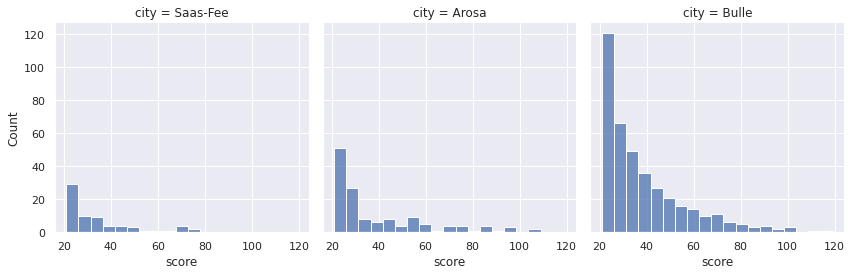

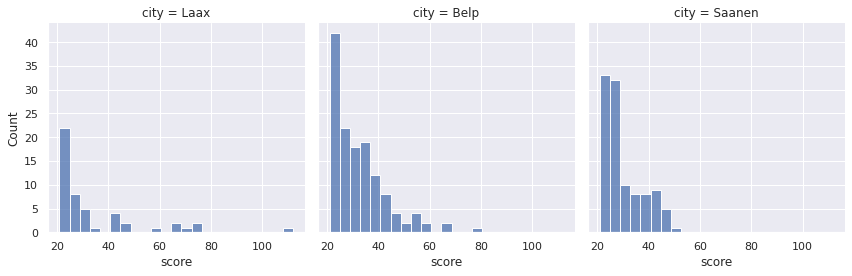

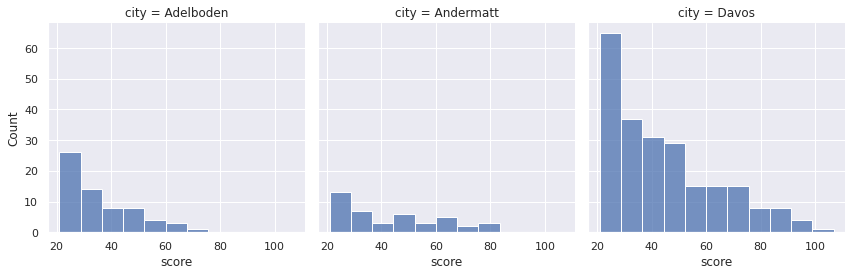

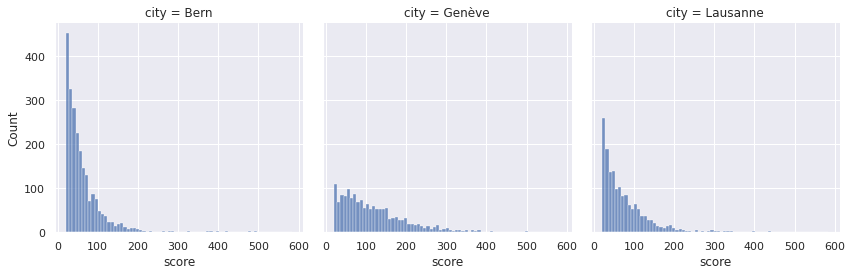

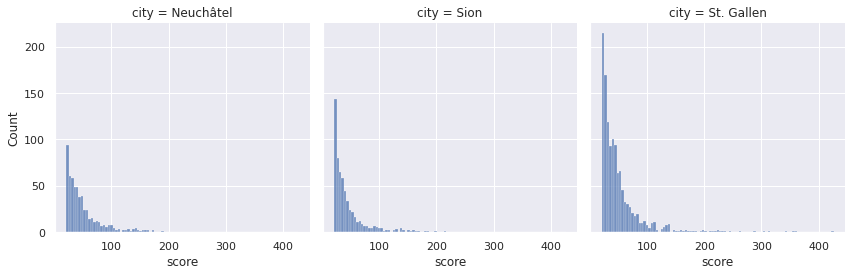

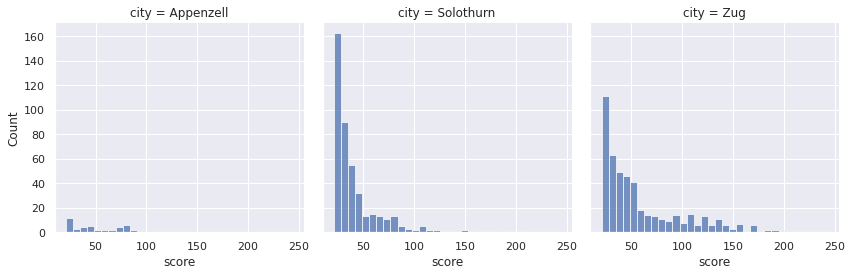

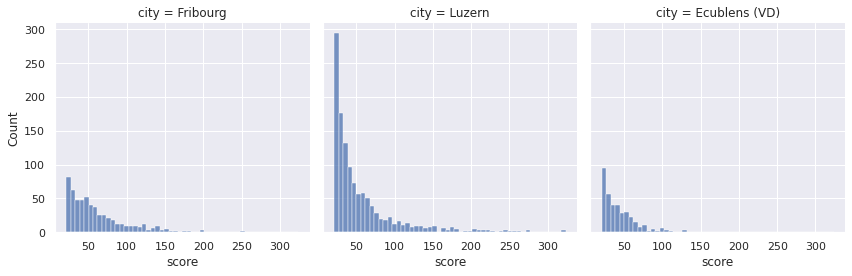

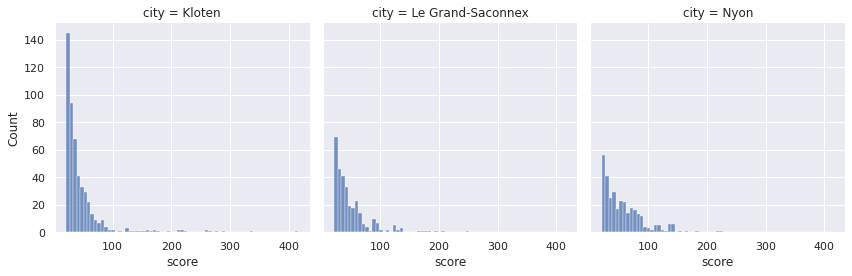

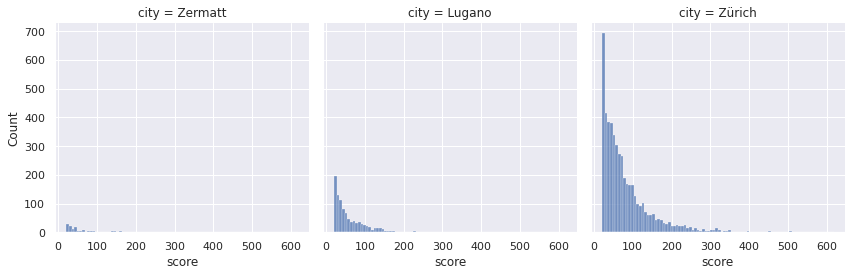

In [10]:
for c in cities:
    d = density[c].reset_index().groupby("tileID").mean()
    d['city'] = c
    res = res.append(d[['score', "city"]])
    count += 1
    if count%3 ==0:
        sns.displot(res, x="score", col="city", height=4)
        count= 0
        res = pd.DataFrame(columns=['score','city'])

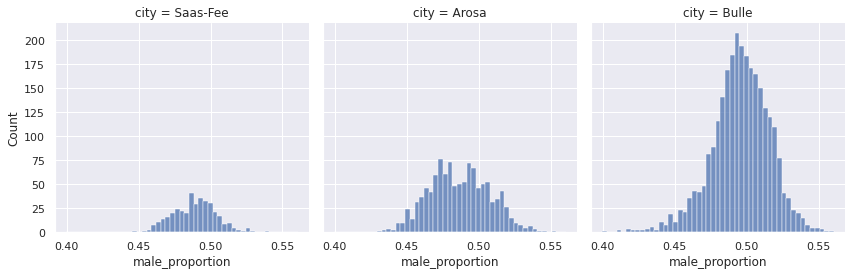

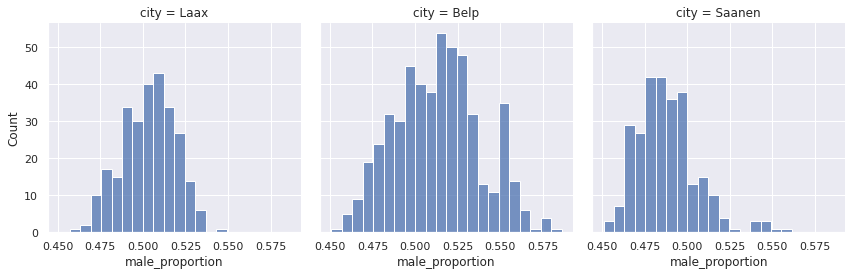

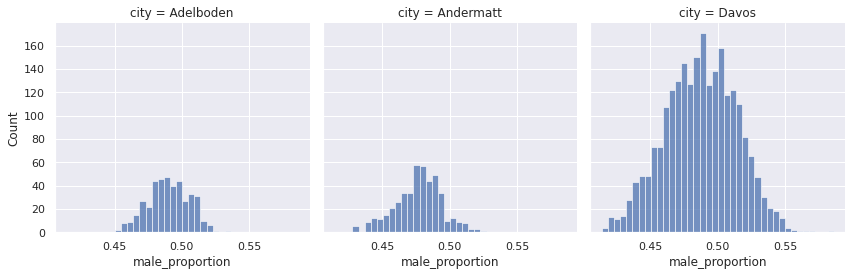

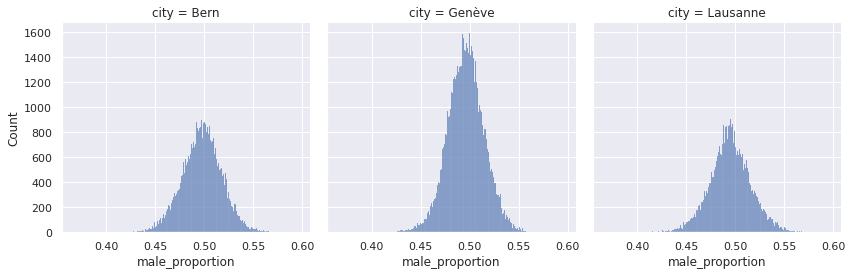

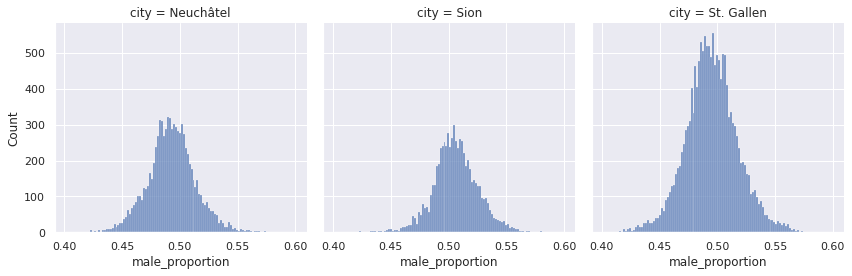

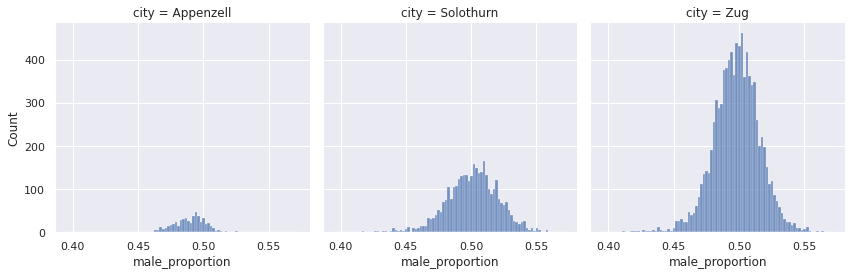

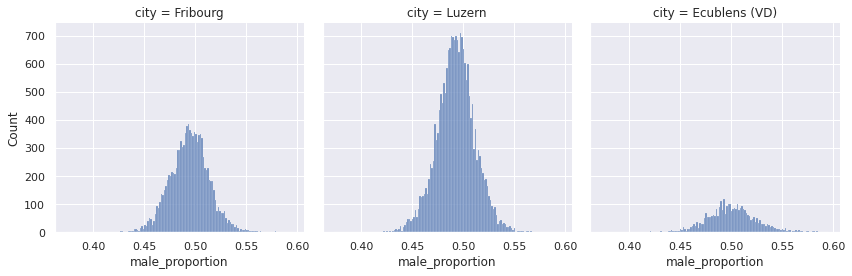

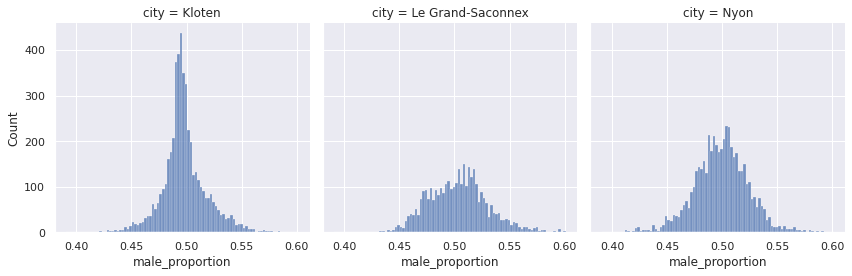

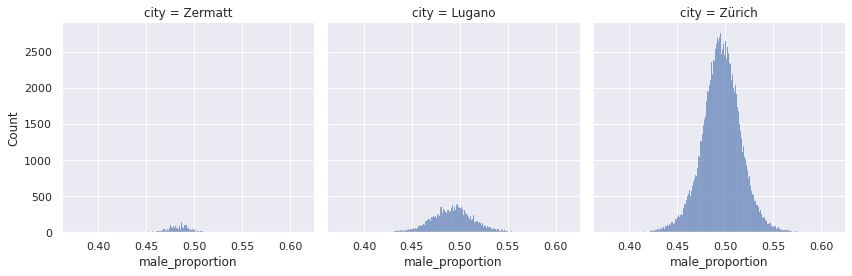

In [11]:
for c in cities:
    demographics[c]['city'] = c

res = pd.DataFrame(columns=['male_proportion','city'])
count = 0
for c in cities:
    res = res.append(demographics[c].reset_index()[['male_proportion', "city"]])
    count += 1
    if count%3 ==0:
        sns.displot(res, x="male_proportion", col="city", height=4)
        count= 0
        res = pd.DataFrame(columns=['male_proportion','city'])

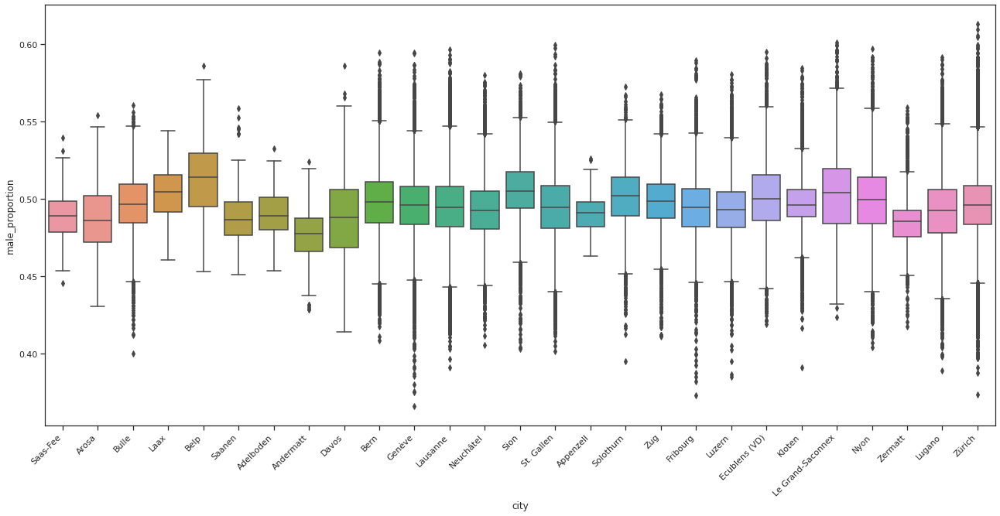

In [12]:

res = pd.DataFrame(columns=['male_proportion','city'])
for c in cities:
    res = res.append(demographics[c].reset_index()[['male_proportion', "city"]])
    
sns.set_theme(style="ticks", palette="pastel")
fig = plt.gcf()
fig.set_size_inches(22, 10)
chart = sns.boxplot(x="city", y="male_proportion",
            data=res, )
chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()

In [13]:
city = "Ecublens (VD)"
fig = px.scatter_mapbox(tiles["Bulle"].set_index("tileID").join(demographics["Bulle"]).reset_index().set_index("tileID")[["time", "ll_lat", "ll_lon", "male_proportion"]], lat="ll_lat", lon="ll_lon", color="male_proportion", 
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [14]:
city = "Ecublens (VD)"
fig = px.scatter_mapbox(demographics[city].reset_index().set_index("tileID").groupby("tileID").mean()[["male_proportion"]].join(tiles[city].set_index("tileID")), lat="ll_lat", lon="ll_lon", color="male_proportion",
                  color_continuous_scale=px.colors.cyclical.IceFire, size_max=15, zoom=10,
                  mapbox_style="carto-positron")
fig.show()

In [15]:
res = pd.DataFrame(columns=["maleProportion"])
for c in cities:
    res = res.append(pd.DataFrame(demographicsDaily[c]["maleProportion"][demographicsDaily[c]["maleProportion"].notna()]))

In [16]:
res.head()

,maleProportion
27689025,0.479284
27666702,0.491946
27659265,0.493956
27681584,0.493918
27674142,0.495604


In [17]:
res["maleProportion"].std()

0.01755443308382538

In [18]:
res["maleProportion"].mean()

0.4963322828640363

In [19]:
px.box( res["maleProportion"])

In [20]:
# ["Andermatt", "Davos", "Bulle", "Bern", "Genève", "Lausanne", "Zurich", "Neuchâtel", "Sion", "St. Gallen", "Appenzell", "Solothurn", "Zug", "Fribourg", "Luzern", "Ecublens (VD)"]

res = pd.DataFrame(columns=['male_proportion', "time", 'city'])
for c in ["Bern", "Genève", "Lausanne", "Zürich", "Neuchâtel", "Ecublens (VD)", "Andermatt", "Davos", "Zermatt"]:
    r = demographics[c].reset_index()[["time", "male_proportion"]]
    r['time'] = r['time'].map(lambda t : t.split("T")[1].split(":")[0])
    r["city"] = c
    res = res.append(r)

Text(0.5, 1.0, 'Male population over time')

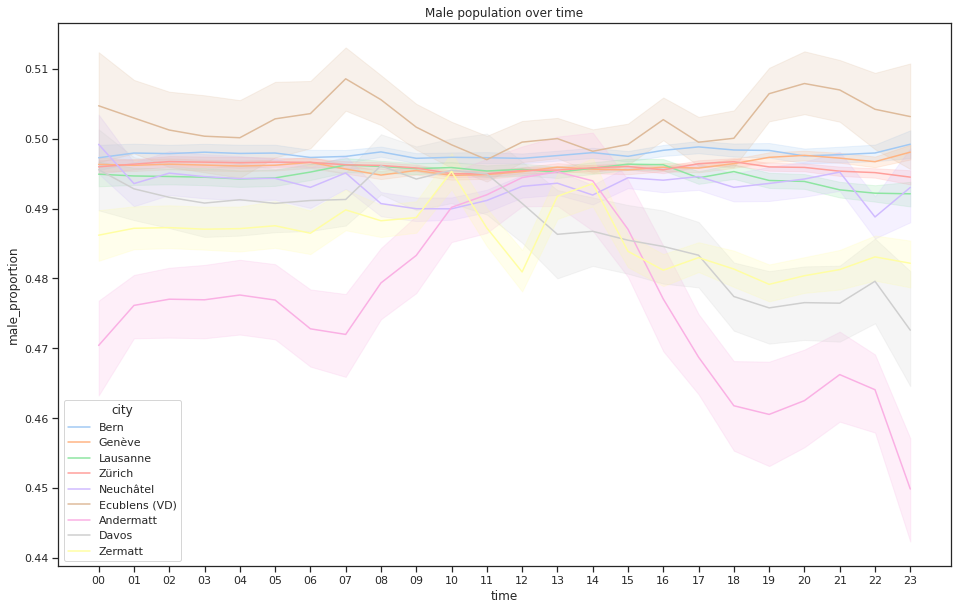

In [21]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
sns.lineplot(x="time", y="male_proportion",
            data=res, hue = "city").set_title("Male population over time")

# Silimarity

Text(0.5, 1.0, 'Geneva population Density over time')

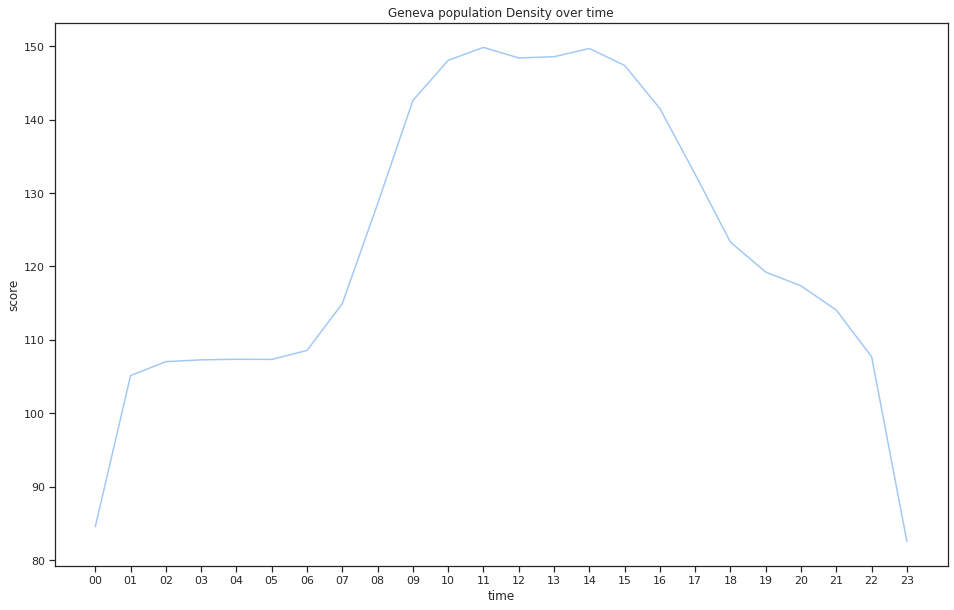

In [22]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
res=density["Genève"].reset_index().groupby("time").mean().reset_index()
res['time'] = res['time'].map(lambda t : t.split("T")[1].split(":")[0])
sns.lineplot(data=res, x="time", y="score").set_title("Geneva population Density over time")

In [23]:
allDensity = pd.DataFrame(columns=["tileID", "time", "score", "city"])
allDensity = allDensity.set_index(["tileID", "time"])

for c in density:
    normalDensity = density[c].copy()
    normalDensity = normalDensity.reset_index().groupby(["time", "city"]).mean().reset_index()[["time", "city", "score"]]
    normalDensity["score"] = (normalDensity.score ) / (normalDensity.score.max())
    allDensity = allDensity.append(normalDensity)
    
allDensity['time'] = allDensity['time'].map(lambda t : t.split("T")[1].split(":")[0])
allDensity.time = pd.to_numeric(allDensity.time)

Text(0.5, 0, 'Hour of the day')

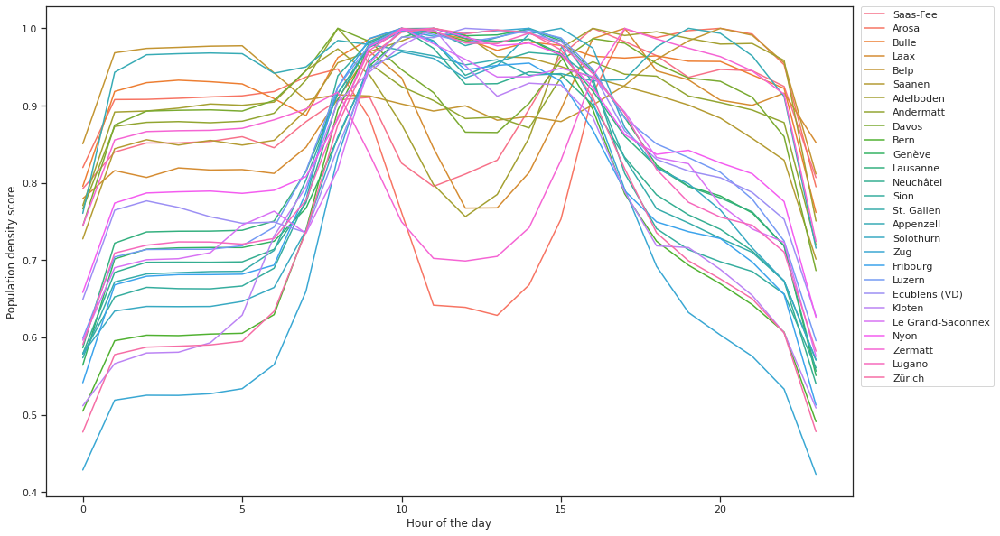

In [24]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
sns.lineplot(x="time", y="score",
            data=allDensity, hue = "city")
plt.legend(bbox_to_anchor=(1.01, 1),borderaxespad=0)
plt.ylabel("Population density score")
plt.xlabel("Hour of the day")


In [25]:
fig = px.line(allDensity, x="time", y="score", color = "city", 
              labels={
                     "score": "Population density score",
                     "time": "Hour of the day",
                 })
fig.show()

In [26]:
res = demographics["Zürich"].dropna().groupby(["age_cat"]).mean().reset_index()

In [27]:
np.vstack([np.array([np.append(res["age_distribution"].to_numpy(),res["male_proportion"].to_numpy()).tolist()]), np.array([np.append(res["age_distribution"].to_numpy(),res["male_proportion"].to_numpy()).tolist()])])

array([[0.18162162, 0.27834503, 0.37291478, 0.16711857, 0.49565097,
        0.49565097, 0.49565097, 0.49565097],
       [0.18162162, 0.27834503, 0.37291478, 0.16711857, 0.49565097,
        0.49565097, 0.49565097, 0.49565097]])

In [28]:
demographics["Andermatt"].head()

age_cat age_distribution  male_proportion  \
tileID   time                                                            
36497355 2020-01-27T00:00:00    None             None         0.480743   
         2020-01-27T01:00:00    None             None         0.479374   
         2020-01-27T02:00:00    None             None         0.479589   
         2020-01-27T03:00:00    None             None         0.479890   
         2020-01-27T04:00:00    None             None         0.480757   

                                   city  
tileID   time                            
36497355 2020-01-27T00:00:00  Andermatt  
         2020-01-27T01:00:00  Andermatt  
         2020-01-27T02:00:00  Andermatt  
         2020-01-27T03:00:00  Andermatt  
         2020-01-27T04:00:00  Andermatt

In [29]:
# create vector representation

start  = True
for c in cities:
    res = demographics[c].dropna().groupby(["age_cat"]).mean().reset_index()
    temp =  res["male_proportion"].to_numpy()
    if len(temp) == 0:
        temp = np.zeros(4)+0.5
    res = density[c].reset_index().groupby("time").mean().reset_index()
    res['time'] = res['time'].map(lambda t : t.split("T")[1].split(":")[0])
    temp = np.append(temp, res['score']/res["score"].max())
    if start:
        start = False
        vector_repr = np.array([temp.tolist()])
    else:
        vector_repr= np.vstack([vector_repr, np.array([temp.tolist()])])

In [30]:
#vector_repr= StandardScaler().fit_transform(vector_repr)

In [31]:
db = DBSCAN(eps=0.26, min_samples=2).fit(vector_repr)

core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
core_samples_mask[db.core_sample_indices_] = True
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)


print('Estimated number of clusters: %d' % n_clusters_)
print('Estimated number of noise points: %d' % n_noise_)

Estimated number of clusters: 5
Estimated number of noise points: 0


In [32]:
cityAndLabel = dict()
for n in range(-1, n_clusters_):
    print(f'Cluster {n}')
    for idx, c in enumerate(cities):
           if  db.labels_[idx] == n:
                print(c)
                cityAndLabel[c] = n

Cluster -1
Cluster 0
Saas-Fee
Laax
Adelboden
Cluster 1
Arosa
Zermatt
Cluster 2
Bulle
Belp
Appenzell
Cluster 3
Saanen
Andermatt
Davos
Cluster 4
Bern
Genève
Lausanne
Neuchâtel
Sion
St. Gallen
Solothurn
Zug
Fribourg
Luzern
Ecublens (VD)
Kloten
Le Grand-Saconnex
Nyon
Lugano
Zürich


In [33]:
cityAndLabel

{'Saas-Fee': 0,
 'Laax': 0,
 'Adelboden': 0,
 'Arosa': 1,
 'Zermatt': 1,
 'Bulle': 2,
 'Belp': 2,
 'Appenzell': 2,
 'Saanen': 3,
 'Andermatt': 3,
 'Davos': 3,
 'Bern': 4,
 'Genève': 4,
 'Lausanne': 4,
 'Neuchâtel': 4,
 'Sion': 4,
 'St. Gallen': 4,
 'Solothurn': 4,
 'Zug': 4,
 'Fribourg': 4,
 'Luzern': 4,
 'Ecublens (VD)': 4,
 'Kloten': 4,
 'Le Grand-Saconnex': 4,
 'Nyon': 4,
 'Lugano': 4,
 'Zürich': 4}

In [34]:
allDensity["color"] = allDensity.city.map(cityAndLabel)

In [35]:
allDensity

,score,city,time,color
0,0.792608,Saas-Fee,0,0
1,0.839959,Saas-Fee,1,0
2,0.851698,Saas-Fee,2,0
3,0.851698,Saas-Fee,3,0
4,0.853722,Saas-Fee,4,0
...,...,...,...,...
19,0.699263,Zürich,19,4
20,0.675725,Zürich,20,4
21,0.650036,Zürich,21,4
22,0.605907,Zürich,22,4


<AxesSubplot:xlabel='time', ylabel='score'>

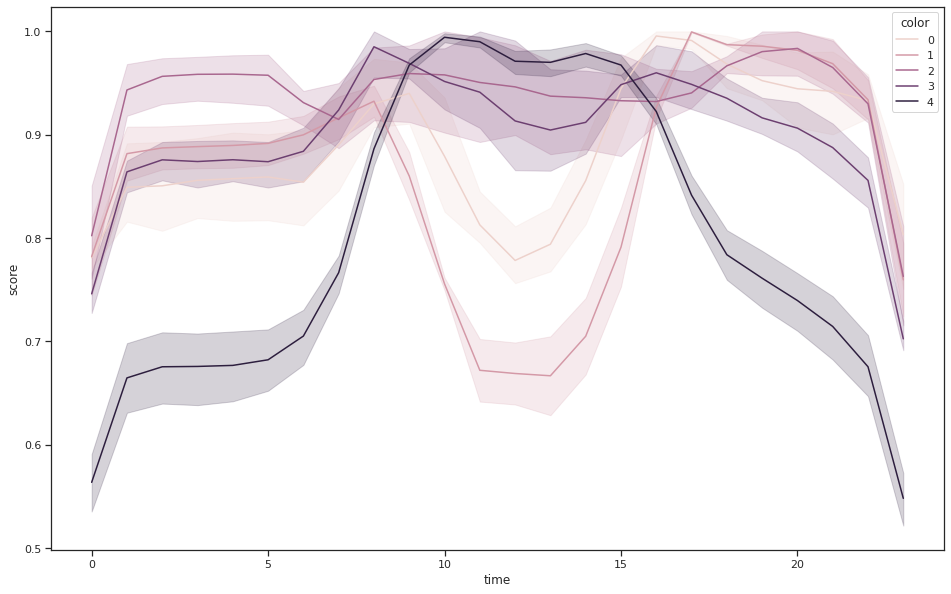

In [36]:
fig = plt.gcf()
fig.set_size_inches(16, 10)
sns.lineplot(x="time", y="score",
            data=allDensity, hue = "color")

In [37]:
from sklearn.decomposition import PCA

In [38]:
# define transform
pca = PCA(n_components=2)
# prepare transform on dataset
pca.fit(vector_repr)
# apply transform to dataset
transformed = pca.transform(vector_repr)

In [39]:
pca.components_

array([[ 0.00324951,  0.00324951,  0.00324951,  0.00324951, -0.25397336,
        -0.26829935, -0.26615448, -0.26771428, -0.26680092, -0.260076  ,
        -0.22419801, -0.16273746, -0.06521335,  0.03517675,  0.11012775,
         0.15038178,  0.14738105,  0.14696293,  0.12841243,  0.06298011,
        -0.03720105, -0.14604714, -0.21110052, -0.23628095, -0.25660008,
        -0.27101633, -0.28220688, -0.24360345],
       [-0.01608855, -0.01608855, -0.01608855, -0.01608855, -0.04666554,
        -0.1595576 , -0.17894215, -0.17373958, -0.16855548, -0.15059596,
        -0.09640081, -0.03341798, -0.05119729, -0.14247362, -0.29491492,
        -0.42558919, -0.44554978, -0.42959569, -0.35031   , -0.20763764,
        -0.0140343 ,  0.05246366, -0.01342001, -0.03218728, -0.04278688,
        -0.03297594, -0.01999019,  0.01486475]])

In [40]:
transformed

array([[-0.45989277,  0.10092259],
       [-0.75169882,  0.41140445],
       [-0.46101545, -0.29392616],
       [-0.38800468,  0.16810458],
       [-0.66179467, -0.12705777],
       [-0.22338327, -0.19407919],
       [-0.58835866,  0.08178235],
       [-0.39173314, -0.05236783],
       [-0.41768181, -0.07706988],
       [ 0.58800837,  0.05374513],
       [ 0.23748272, -0.07037558],
       [ 0.18755849, -0.09100505],
       [ 0.29168773,  0.03295833],
       [ 0.38989694,  0.02825126],
       [ 0.33572246, -0.04098198],
       [-0.54832613, -0.26733876],
       [ 0.35239749,  0.06053005],
       [ 0.83711988,  0.12774344],
       [ 0.37161923,  0.02437103],
       [ 0.17177869, -0.08068263],
       [ 0.10421598, -0.11895138],
       [ 0.52652731,  0.13215042],
       [ 0.2005691 ,  0.00181403],
       [ 0.0215857 , -0.13937165],
       [-0.5613281 ,  0.34411783],
       [ 0.22667732, -0.06829202],
       [ 0.6103701 ,  0.05360438]])

In [41]:
res = pd.DataFrame(transformed)
res["2"] = pd.Series(cities)
res["cluster"] = pd.Series(db.labels_).astype(str).map(lambda t : t if t != "-1" else "Noise")

In [42]:
res

,0,1,2,cluster
0,-0.459893,0.100923,Saas-Fee,0
1,-0.751699,0.411404,Arosa,1
2,-0.461015,-0.293926,Bulle,2
3,-0.388005,0.168105,Laax,0
4,-0.661795,-0.127058,Belp,2
5,-0.223383,-0.194079,Saanen,3
6,-0.588359,0.081782,Adelboden,0
7,-0.391733,-0.052368,Andermatt,3
8,-0.417682,-0.077070,Davos,3
9,0.588008,0.053745,Bern,4


In [43]:
res = res.rename(columns={0: "v1", 1: "v2", "2": "city"})

In [44]:
res.head()

,v1,v2,city,cluster
0,-0.459893,0.100923,Saas-Fee,0
1,-0.751699,0.411404,Arosa,1
2,-0.461015,-0.293926,Bulle,2
3,-0.388005,0.168105,Laax,0
4,-0.661795,-0.127058,Belp,2


In [45]:

px.scatter(res, x="v1", y="v2", hover_data=["city"], color="cluster", labels="city")

In [46]:
cities

['Saas-Fee',
 'Arosa',
 'Bulle',
 'Laax',
 'Belp',
 'Saanen',
 'Adelboden',
 'Andermatt',
 'Davos',
 'Bern',
 'Genève',
 'Lausanne',
 'Neuchâtel',
 'Sion',
 'St. Gallen',
 'Appenzell',
 'Solothurn',
 'Zug',
 'Fribourg',
 'Luzern',
 'Ecublens (VD)',
 'Kloten',
 'Le Grand-Saconnex',
 'Nyon',
 'Zermatt',
 'Lugano',
 'Zürich']

In [47]:
len(cities)

27

In [48]:
preference = np.array([1,0,0,0,0,1,1,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0])

In [49]:
from sklearn.cluster import AffinityPropagation

af = AffinityPropagation(preference=-0.1).fit(transformed)
cluster_centers_indices = af.cluster_centers_indices_
labels = af.labels_
print('Estimated number of clusters: %d' % n_clusters_)
labels = af.labels_

n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)


for n in range(-1, n_clusters_):
    print(f'Cluster {n}')
    for idx, c in enumerate(cities):
           if  af.labels_[idx] == n:
                print(c)

Estimated number of clusters: 5
Cluster -1
Cluster 0
Saas-Fee
Laax
Adelboden
Cluster 1
Saanen
Andermatt
Davos
Cluster 2
Bulle
Belp
Appenzell
Cluster 3
Neuchâtel
Sion
St. Gallen
Solothurn
Fribourg
Cluster 4
Genève
Lausanne
Luzern
Ecublens (VD)
Le Grand-Saconnex
Nyon
Lugano
Cluster 5
Arosa
Zermatt
Cluster 6
Bern
Zug
Kloten
Zürich


/home/jeremy/Documents/SwisscomMit/condaEnv/lib/python3.7/site-packages/sklearn/cluster/_affinity_propagation.py:152: FutureWarning:

'random_state' has been introduced in 0.23. It will be set to None starting from 0.25 which means that results will differ at every function call. Set 'random_state' to None to silence this warning, or to 0 to keep the behavior of versions <0.23.

